In [1]:
# CAM: Classifacation Activation Map
# 用来展示神经网络做出判断的主要部分

In [2]:
from tensorflow.keras.models import load_model

In [3]:
# 加载训练好的网络模型
test_model = load_model('cat_dog_cam_classifier.h5')

In [4]:
# 看网络的结构
test_model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_5 (Conv2D)            (None, 298, 298, 16)      160       
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 149, 149, 16)      0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 147, 147, 32)      4640      
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 73, 73, 32)        0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 71, 71, 64)        18496     
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 35, 35, 64)        0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 33, 33, 128)       73856     
__________

In [5]:
import cv2
def cvLoadImg(path):
    img = mpimg.imread(path)
    img = cv2.resize(img, dsize=(300, 300), interpolation=cv2.INTER_CUBIC)/255.
    img = np.expand_dims(img, axis=0)
    img = np.expand_dims(img, axis=-1)
    return img

In [6]:
from keras.preprocessing import image
import numpy as np
import os
import time
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import tensorflow.keras.backend as K

Using TensorFlow backend.


In [7]:
def isCat(path):
    test_img = cvLoadImg(path)
    classes = test_model.predict(test_img)
    class_idx = np.argmax(classes[0])
    if class_idx == 0:
        return True
    else:
        return False

In [255]:
def showCAM(path):
    if isCat(path):
        print('       This is a cat.')
    else:
        print('       This is a dog.')
    img = cvLoadImg(path)
    # print(img.shape)
    preds = test_model.predict(img)
    # print(preds)
    class_idx = np.argmax(preds[0])
    # print(class_idx)
    class_output = test_model.output[:, class_idx]
    # print(class_output)
    last_conv_layer = test_model.get_layer("conv2d_9")
    #print(last_conv_layer)
    grads = K.gradients(class_output, last_conv_layer.output)[0]
    #print(grads)
    pooled_grads = K.mean(grads, axis=(0, 1, 2))
    iterate = K.function([test_model.input], [pooled_grads, last_conv_layer.output[0]])
    pooled_grads_value, conv_layer_output_value = iterate([img])
    for i in range(64):
        conv_layer_output_value[:, :, i] *= pooled_grads_value[i]

    heatmap = np.mean(conv_layer_output_value, axis=-1)
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap)

    img_path = path
    img = cv2.imread(img_path)
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed_img = cv2.addWeighted(img, 0.6, heatmap, 0.4, 0)
    fig = plt.gcf()
    fig.set_size_inches(5 * 2, 5 * 1)    
    ax1 = plt.subplot(1,2,1)
    ax1.set_xticks([])
    ax1.set_yticks([])
    ax1.imshow(img)
    ax2 = plt.subplot(1,2,2)
    ax2.set_xticks([])
    ax2.set_yticks([])
    ax2.imshow(superimposed_img)

In [256]:
test_path = './test_images/'
test_list = os.listdir(test_path)

       This is a dog.


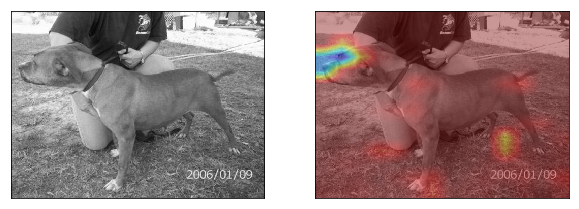

In [257]:
showCAM(test_path+test_list[30])

       This is a cat.


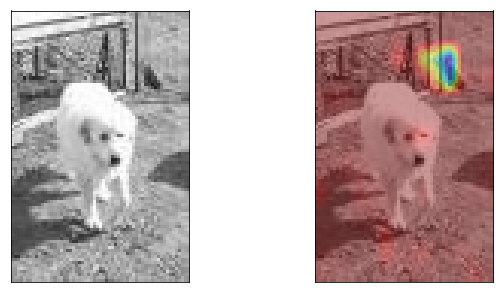

In [258]:
# 判断错误
showCAM(test_path+test_list[31])

       This is a cat.


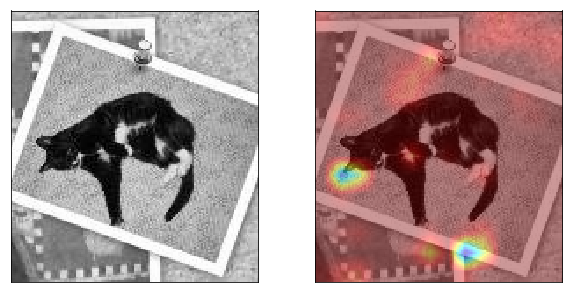

In [259]:
showCAM(test_path+test_list[32])

       This is a dog.


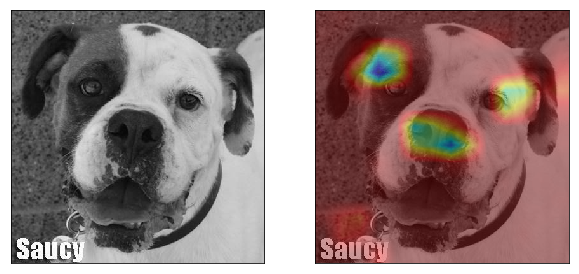

In [260]:
showCAM(test_path+test_list[33])

       This is a cat.


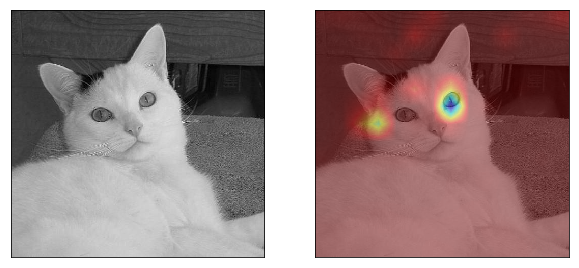

In [261]:
showCAM(test_path+test_list[34])

       This is a cat.


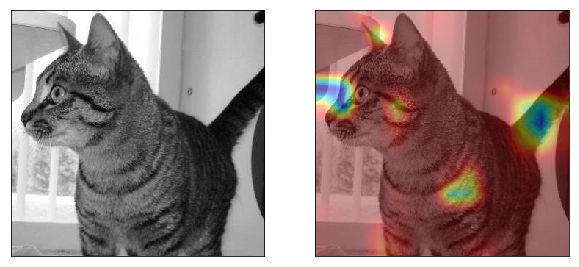

In [262]:
showCAM(test_path+test_list[35])

       This is a dog.


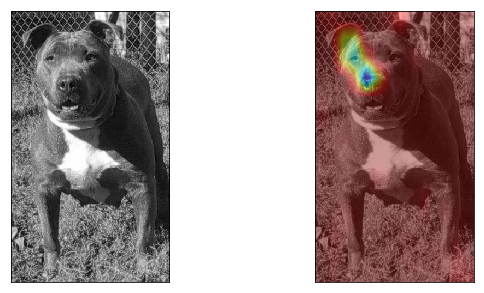

In [263]:
showCAM(test_path+test_list[36])

       This is a dog.


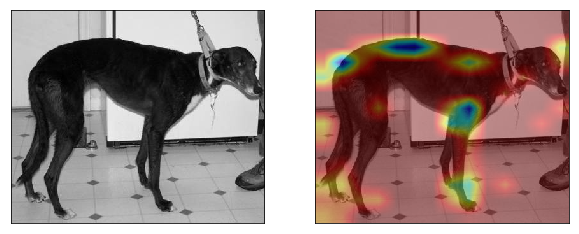

In [264]:
showCAM(test_path+test_list[37])

       This is a cat.


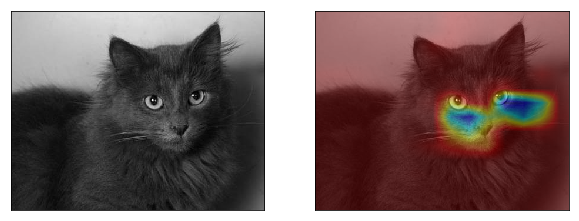

In [265]:
showCAM(test_path+test_list[38])

       This is a dog.


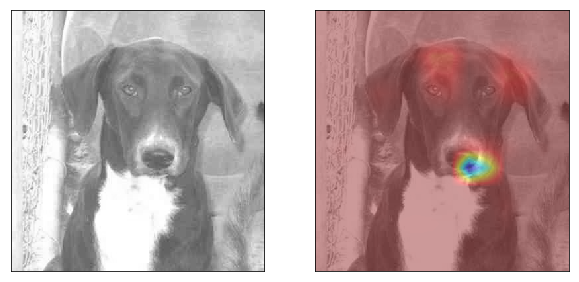

In [266]:
showCAM(test_path+test_list[39])

       This is a cat.


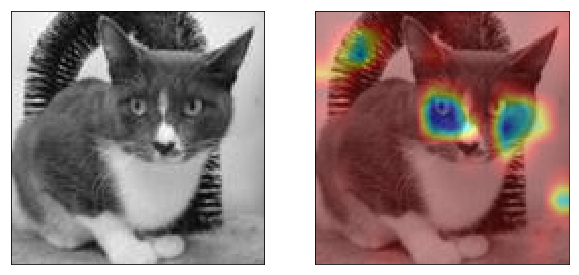

In [267]:
showCAM(test_path+test_list[40])

       This is a dog.


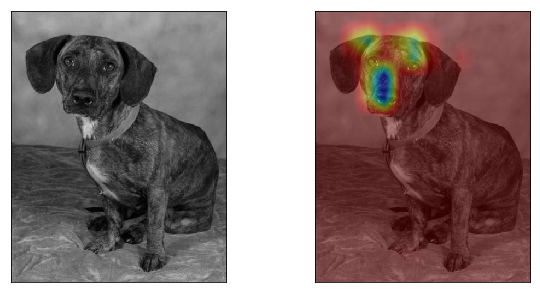

In [268]:
showCAM(test_path+test_list[41])

       This is a cat.


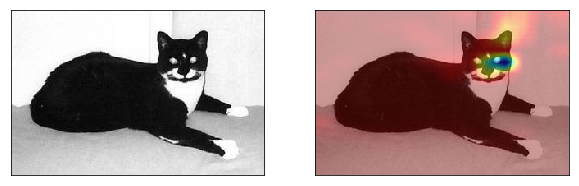

In [269]:
showCAM(test_path+test_list[43])

       This is a cat.


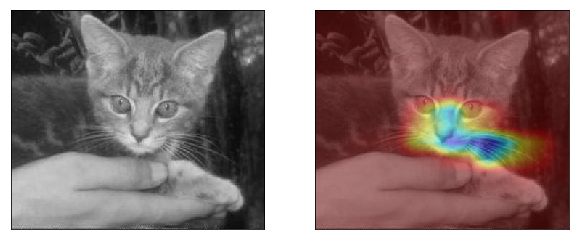

In [270]:
showCAM(test_path+test_list[44])

       This is a cat.


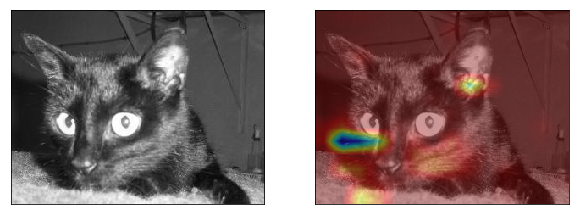

In [271]:
showCAM(test_path+test_list[45])

       This is a cat.


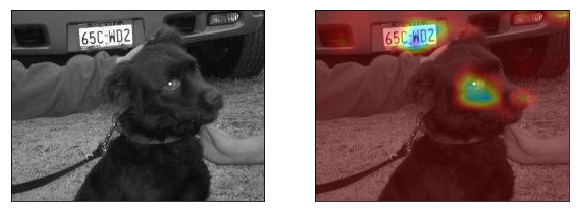

In [272]:
showCAM(test_path+test_list[46])

       This is a cat.


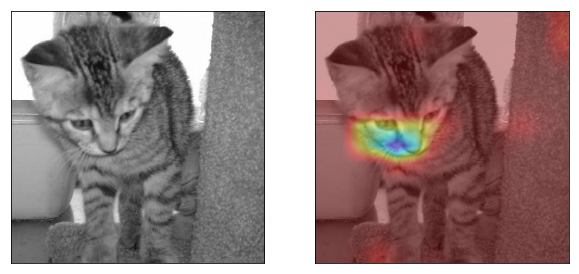

In [273]:
showCAM(test_path+test_list[47])

       This is a cat.


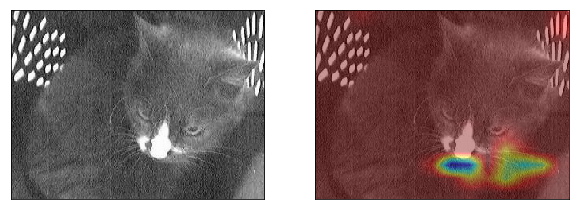

In [274]:
showCAM(test_path+test_list[48])

       This is a cat.


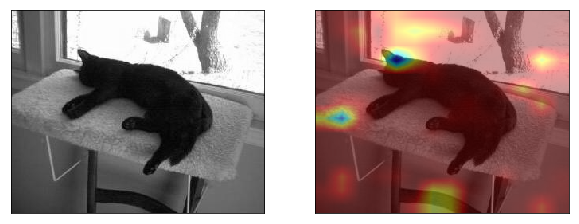

In [275]:
showCAM(test_path+test_list[49])

       This is a dog.


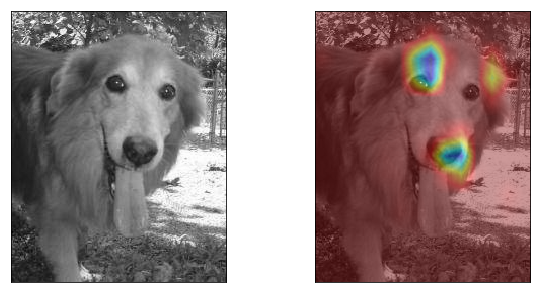

In [276]:
showCAM(test_path+test_list[50])

       This is a dog.


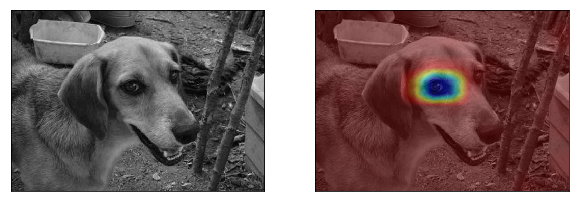

In [277]:
showCAM(test_path+test_list[51])

       This is a dog.


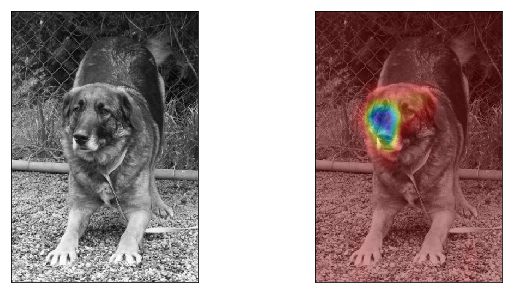

In [278]:
showCAM(test_path+test_list[52])

       This is a dog.


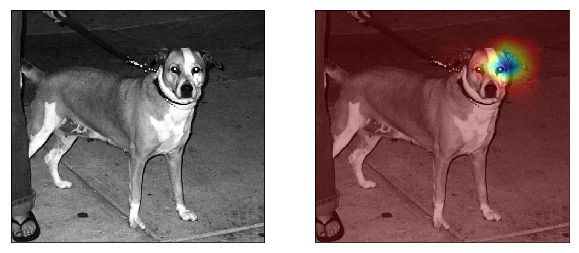

In [279]:
showCAM(test_path+test_list[53])

       This is a dog.


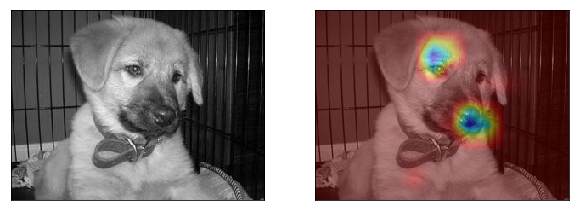

In [280]:
showCAM(test_path+test_list[54])

       This is a cat.


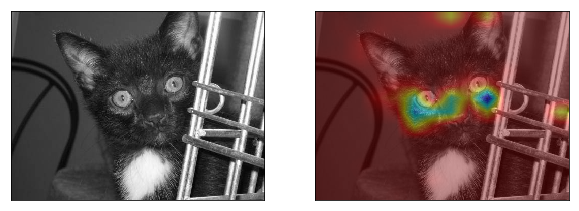

In [281]:
showCAM(test_path+test_list[55])

       This is a dog.


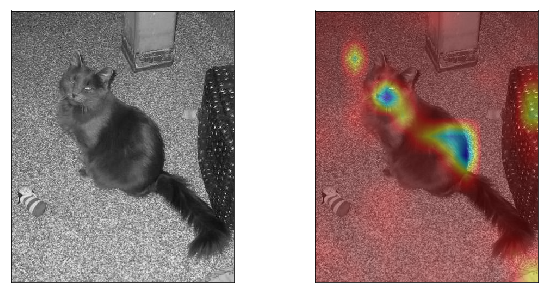

In [282]:
# 失误
showCAM(test_path+test_list[56])

       This is a cat.


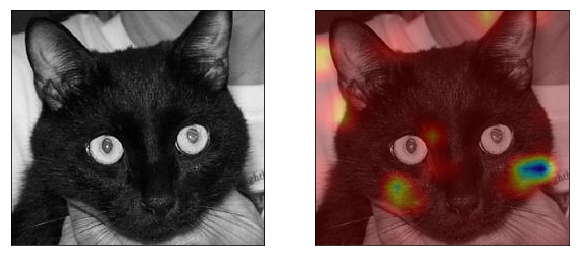

In [283]:
showCAM(test_path+test_list[57])

       This is a cat.


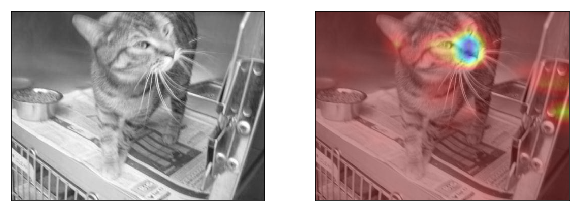

In [284]:
showCAM(test_path+test_list[58])

       This is a dog.


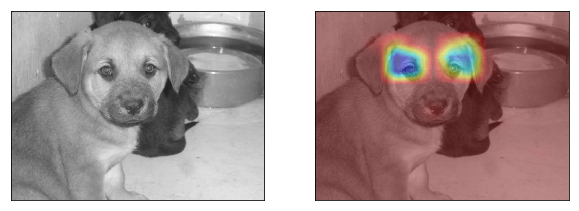

In [285]:
showCAM(test_path+test_list[59])

       This is a cat.


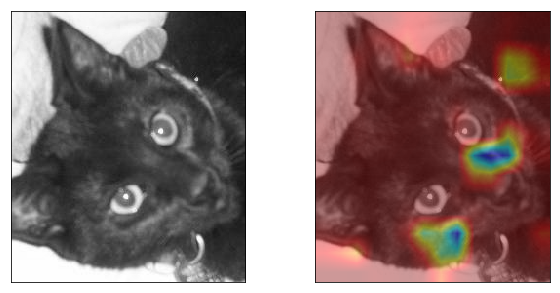

In [286]:
showCAM(test_path+test_list[60])

       This is a cat.


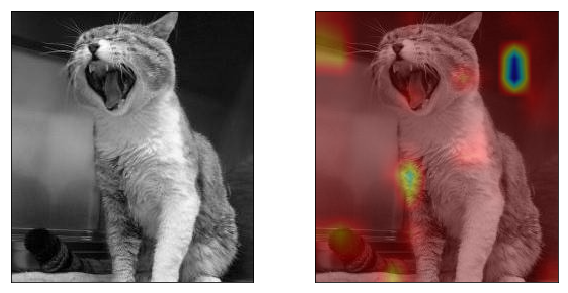

In [287]:
showCAM(test_path+test_list[61])

       This is a cat.


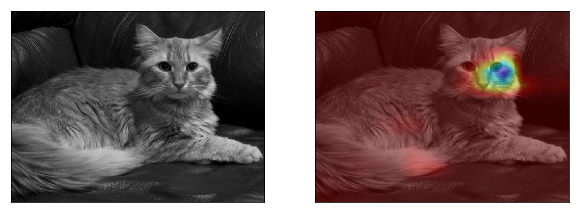

In [288]:
showCAM(test_path+test_list[62])

       This is a cat.


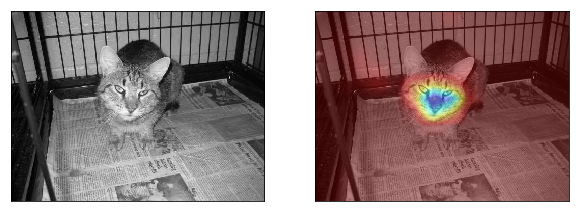

In [289]:
showCAM(test_path+test_list[63])

       This is a dog.


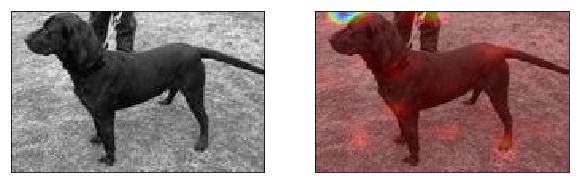

In [290]:
showCAM(test_path+test_list[64])

       This is a cat.


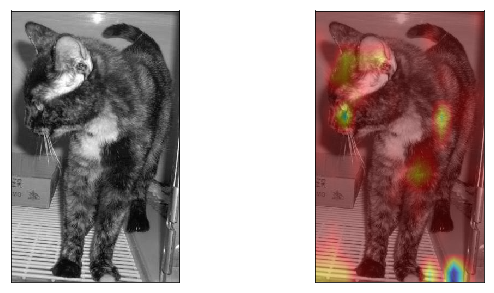

In [291]:
showCAM(test_path+test_list[65])

       This is a dog.


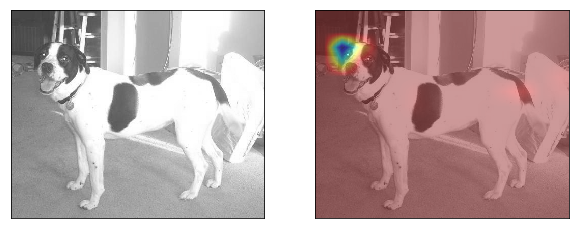

In [292]:
showCAM(test_path+test_list[66])

       This is a cat.


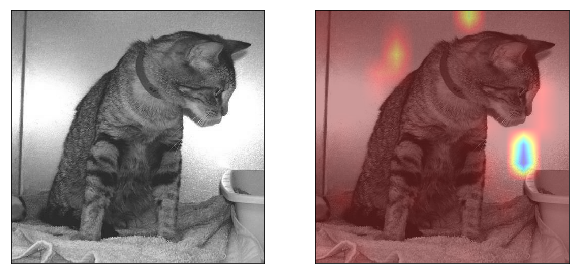

In [293]:
showCAM(test_path+test_list[67])

       This is a cat.


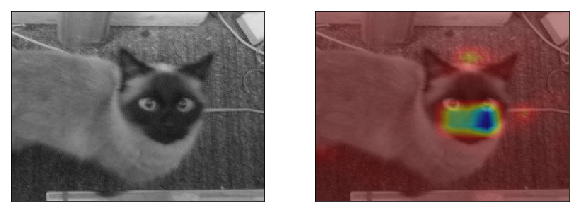

In [294]:
showCAM(test_path+test_list[68])

       This is a cat.


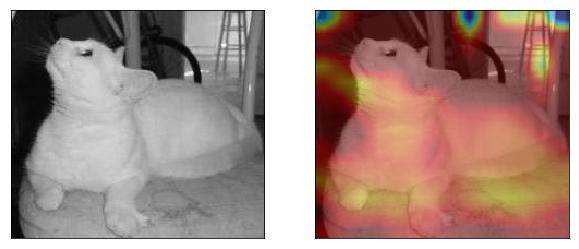

In [295]:
showCAM(test_path+test_list[69])

       This is a cat.


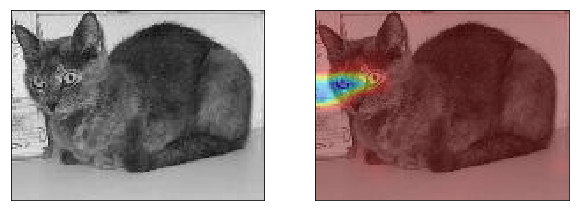

In [296]:
showCAM(test_path+test_list[70])

       This is a dog.


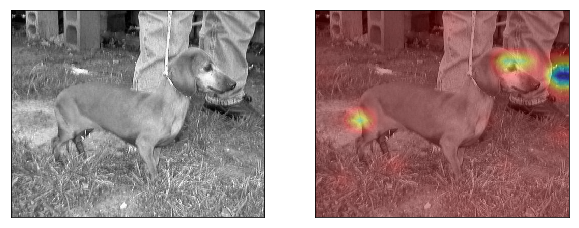

In [297]:
showCAM(test_path+test_list[71])

       This is a cat.


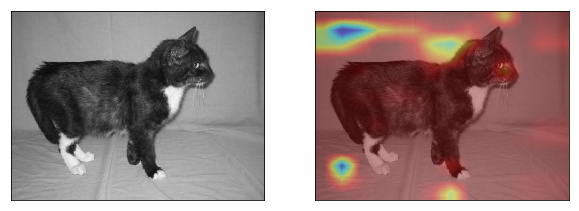

In [298]:
showCAM(test_path+test_list[72])

       This is a dog.


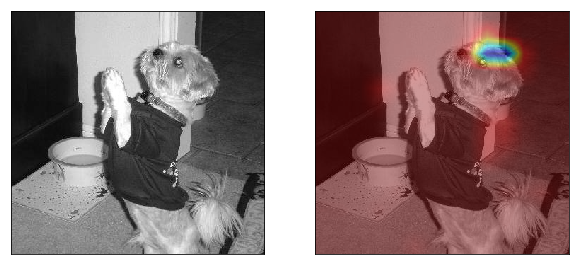

In [299]:
showCAM(test_path+test_list[73])

       This is a cat.


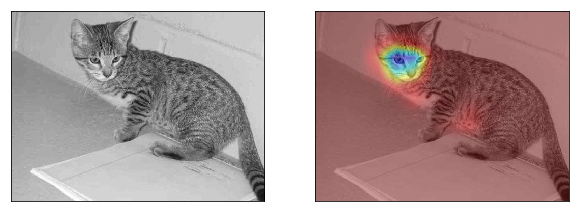

In [300]:
showCAM(test_path+test_list[74])

       This is a dog.


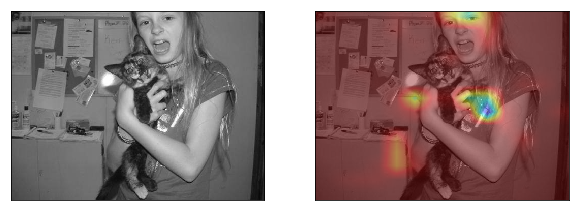

In [301]:
# 出错
showCAM(test_path+test_list[75])

       This is a cat.


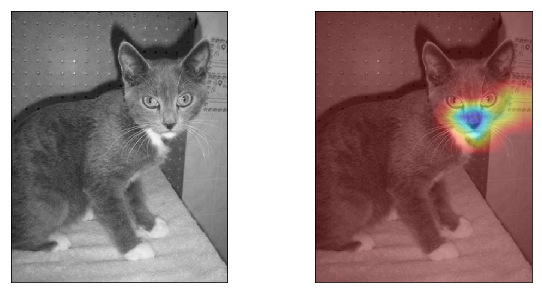

In [302]:
showCAM(test_path+test_list[76])

       This is a cat.


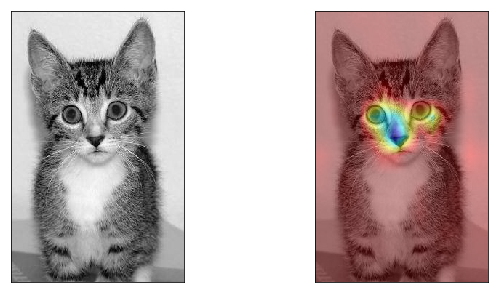

In [303]:
showCAM(test_path+test_list[77])

       This is a dog.


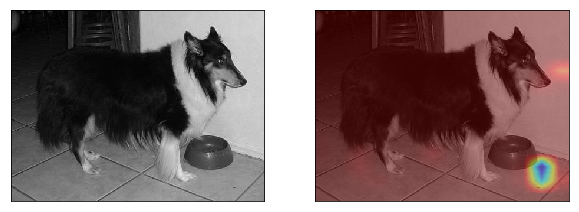

In [304]:
showCAM(test_path+test_list[78])

       This is a cat.


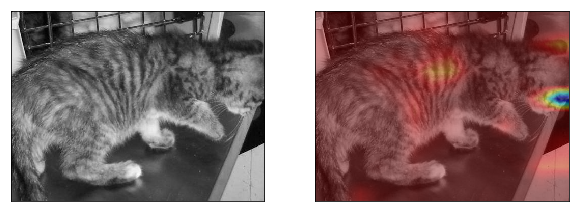

In [305]:
showCAM(test_path+test_list[79])

       This is a dog.


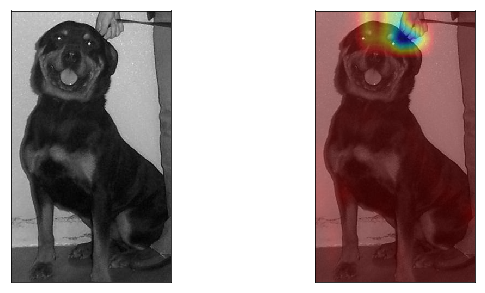

In [306]:
showCAM(test_path+test_list[80])

       This is a dog.


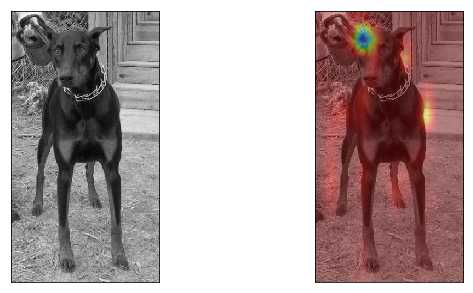

In [307]:
showCAM(test_path+test_list[81])

       This is a cat.


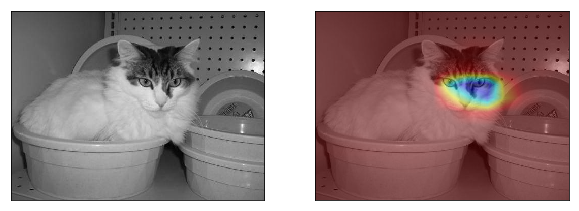

In [308]:
showCAM(test_path+test_list[82])

       This is a dog.


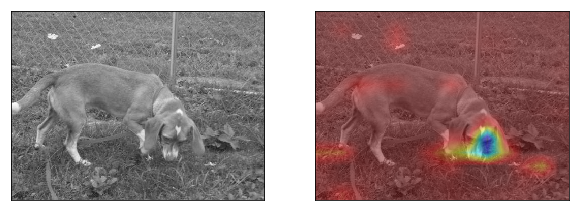

In [309]:
showCAM(test_path+test_list[83])

       This is a cat.


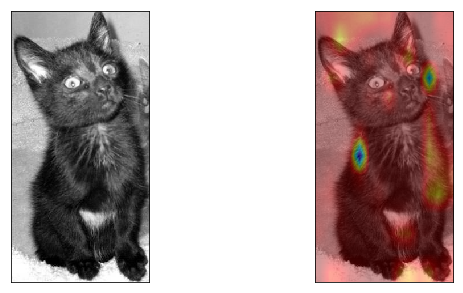

In [310]:
showCAM(test_path+test_list[84])

       This is a cat.


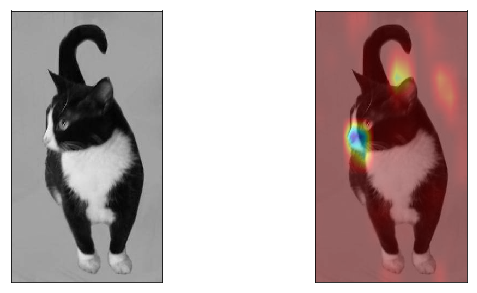

In [311]:
showCAM(test_path+test_list[85])

       This is a cat.


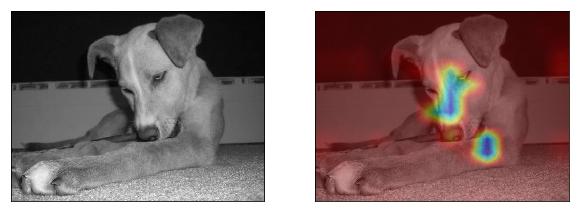

In [312]:
showCAM(test_path+test_list[86])

       This is a cat.


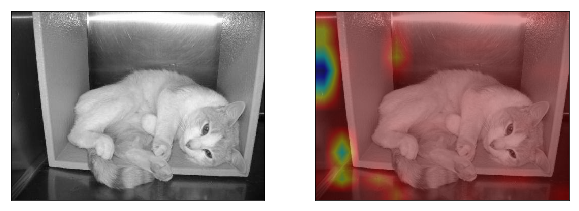

In [313]:
showCAM(test_path+test_list[87])

       This is a dog.


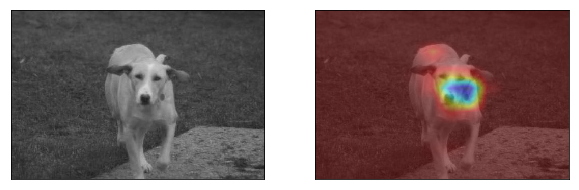

In [314]:
showCAM(test_path+test_list[88])

       This is a dog.


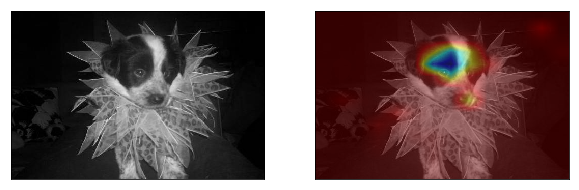

In [315]:
showCAM(test_path+test_list[89])

       This is a dog.


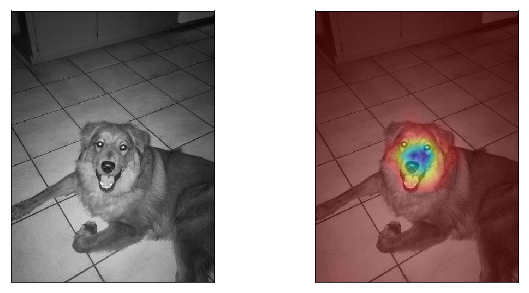

In [316]:
showCAM(test_path+test_list[90])

       This is a cat.


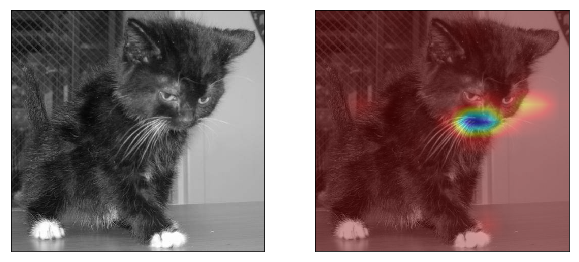

In [317]:
showCAM(test_path+test_list[91])

       This is a dog.


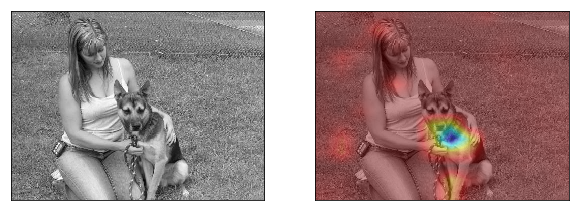

In [318]:
showCAM(test_path+test_list[92])

       This is a dog.


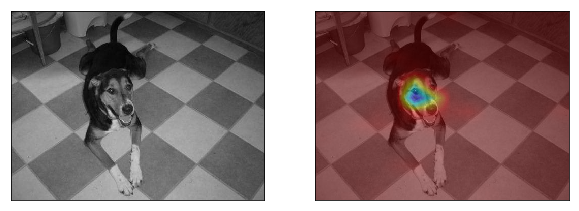

In [319]:
showCAM(test_path+test_list[93])

       This is a cat.


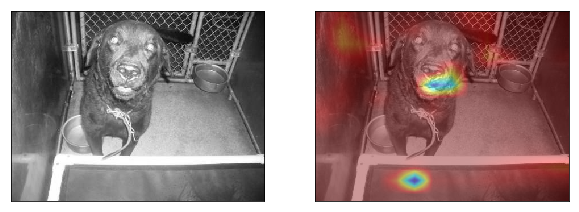

In [320]:
# 出错
showCAM(test_path+test_list[94])

       This is a cat.


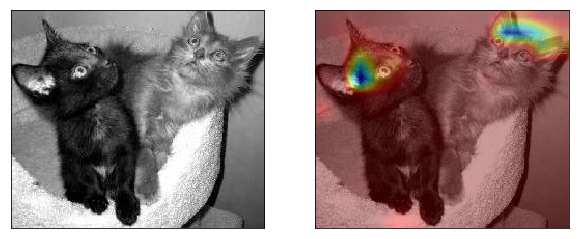

In [321]:
showCAM(test_path+test_list[95])

       This is a cat.


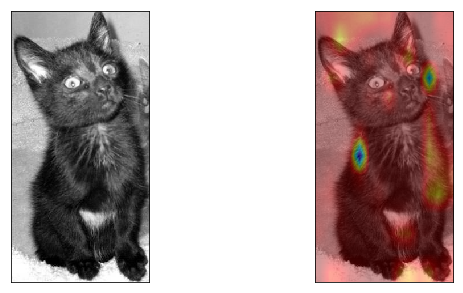

In [322]:
showCAM(test_path+test_list[96])

       This is a dog.


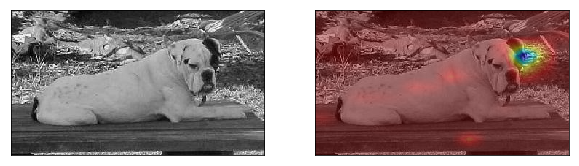

In [323]:
showCAM(test_path+test_list[97])

       This is a dog.


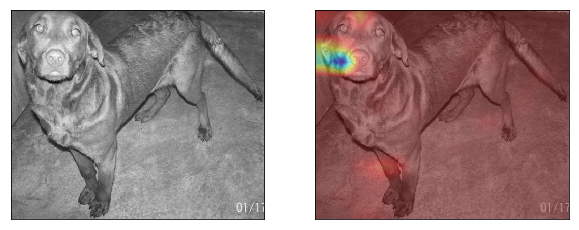

In [324]:
showCAM(test_path+test_list[98])

       This is a dog.


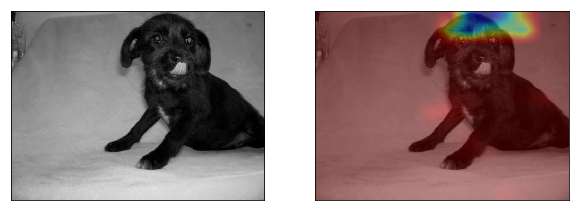

In [325]:
showCAM(test_path+test_list[99])

       This is a cat.


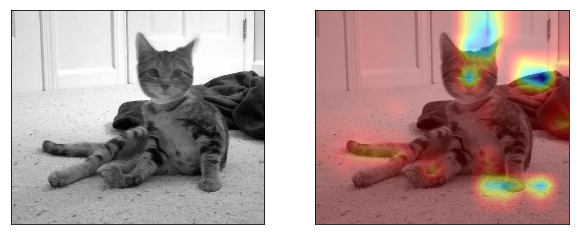

In [326]:
showCAM(test_path+test_list[100])

       This is a dog.


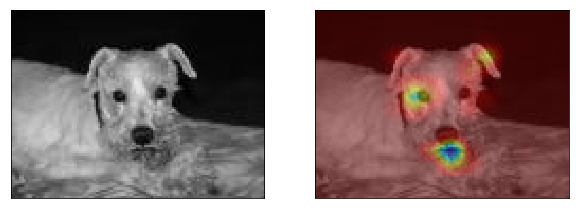

In [327]:
showCAM(test_path+test_list[101])

       This is a cat.


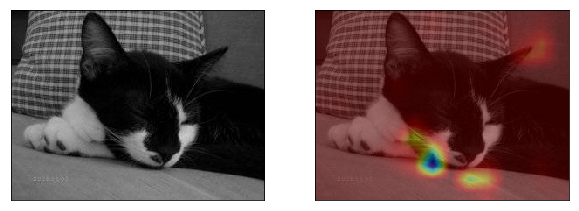

In [328]:
showCAM(test_path+test_list[102])

       This is a cat.


/home/jack/.jackprograms/envs/gpu_tf_keras/lib/python3.6/site-packages/ipykernel_launcher.py:26: RuntimeWarning: invalid value encountered in true_divide


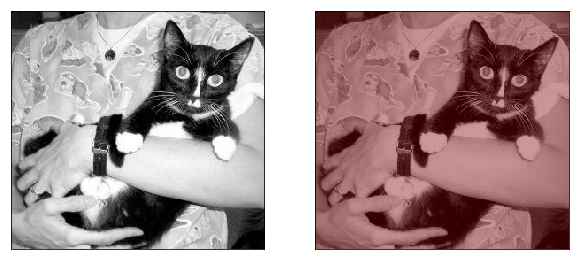

In [329]:
showCAM(test_path+test_list[103])

       This is a cat.


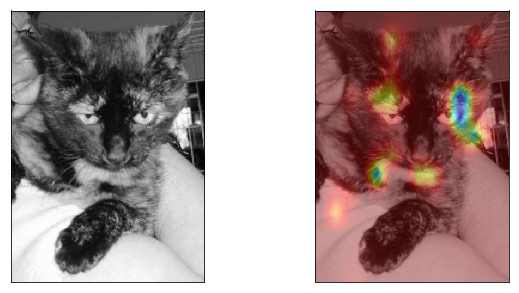

In [330]:
showCAM(test_path+test_list[104])

       This is a cat.


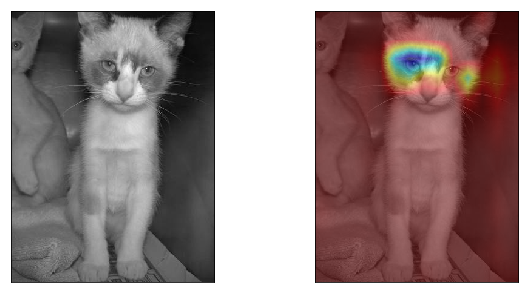

In [331]:
showCAM(test_path+test_list[105])

       This is a cat.


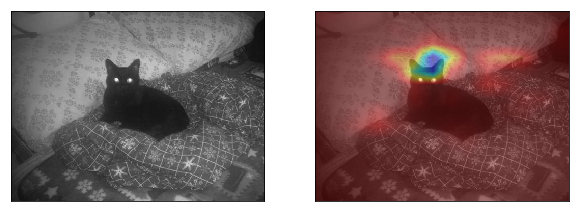

In [332]:
showCAM(test_path+test_list[106])

       This is a dog.


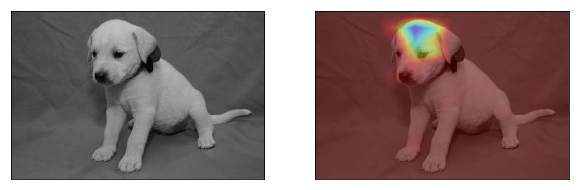

In [333]:
showCAM(test_path+test_list[107])

       This is a dog.


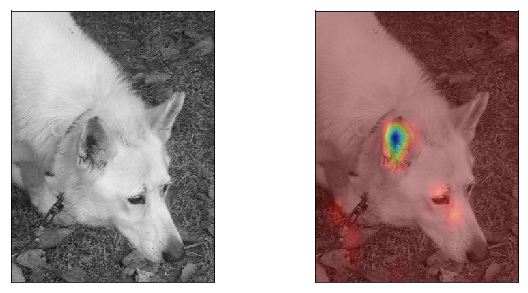

In [334]:
showCAM(test_path+test_list[108])

       This is a dog.


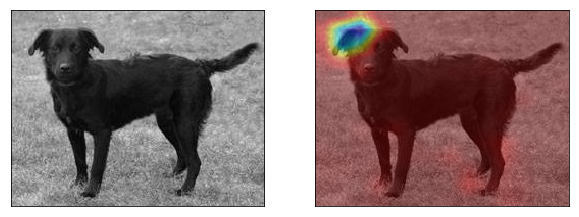

In [335]:
showCAM(test_path+test_list[109])

       This is a cat.


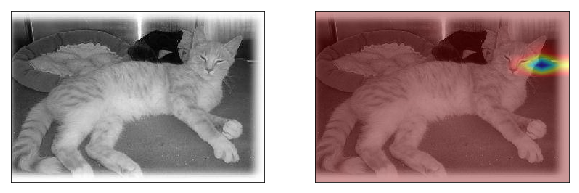

In [336]:
showCAM(test_path+test_list[110])

       This is a dog.


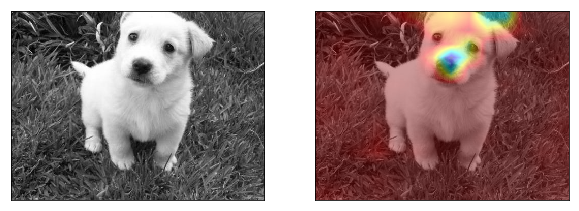

In [337]:
showCAM(test_path+test_list[111])

       This is a cat.


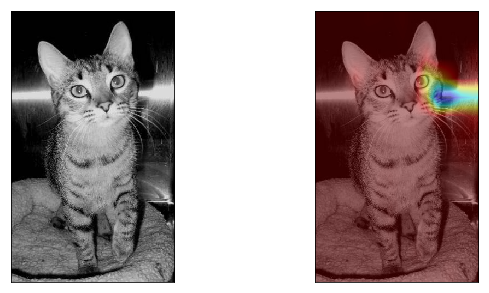

In [338]:
showCAM(test_path+test_list[112])

       This is a cat.


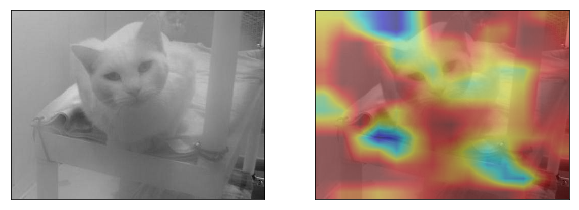

In [339]:
showCAM(test_path+test_list[123])

       This is a cat.


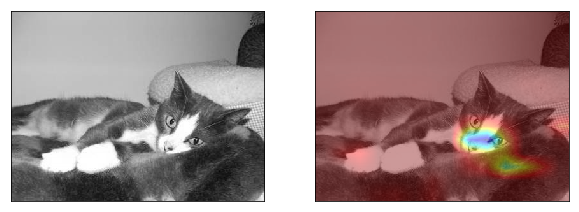

In [340]:
showCAM(test_path+test_list[124])

       This is a cat.


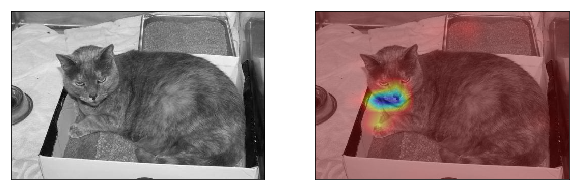

In [341]:
showCAM(test_path+test_list[125])

       This is a dog.


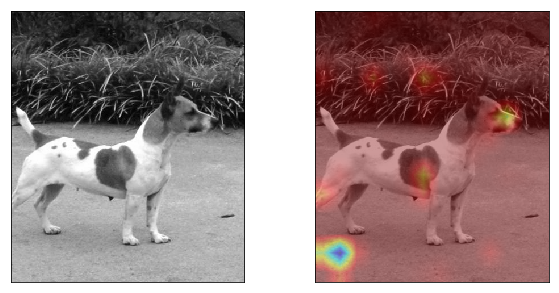

In [343]:
showCAM(test_path+test_list[127])

       This is a dog.


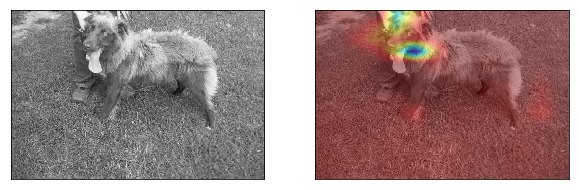

In [344]:
showCAM(test_path+test_list[128])

       This is a cat.


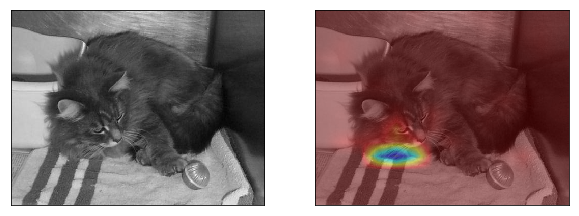

In [345]:
showCAM(test_path+test_list[129])

       This is a cat.


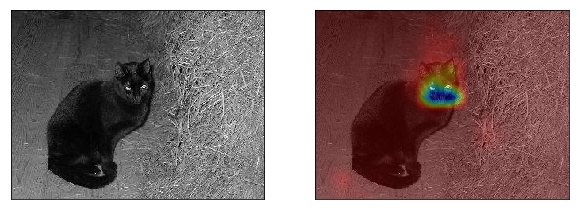

In [346]:
showCAM(test_path+test_list[130])

       This is a dog.


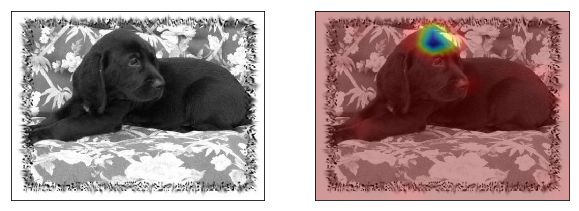

In [347]:
showCAM(test_path+test_list[131])

       This is a dog.


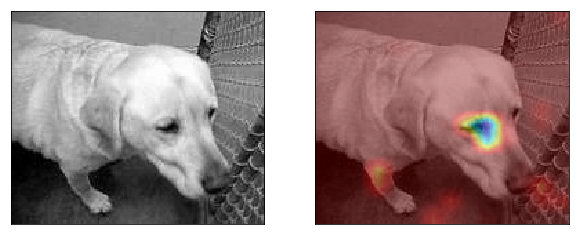

In [348]:
showCAM(test_path+test_list[132])

       This is a cat.


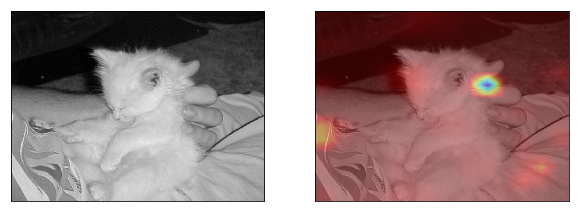

In [349]:
showCAM(test_path+test_list[133])

       This is a dog.


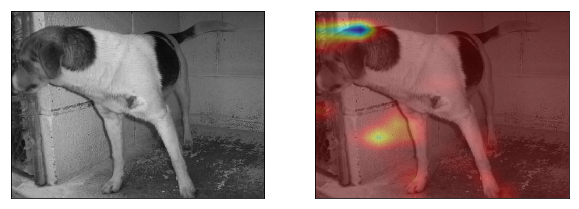

In [350]:
showCAM(test_path+test_list[134])

       This is a dog.


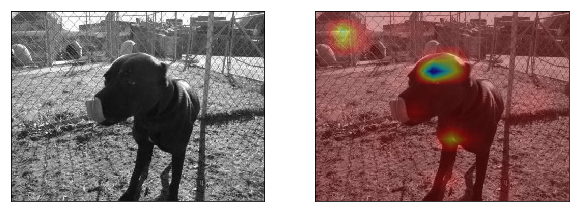

In [351]:
showCAM(test_path+test_list[135])

       This is a dog.


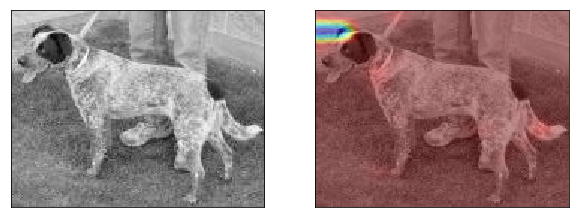

In [352]:
showCAM(test_path+test_list[136])

       This is a dog.


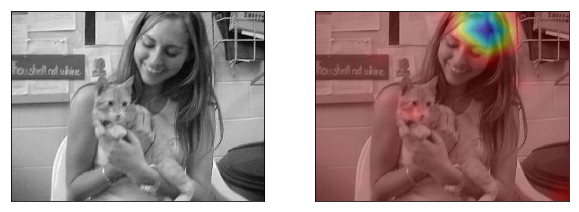

In [353]:
# 失误
showCAM(test_path+test_list[137])

       This is a cat.


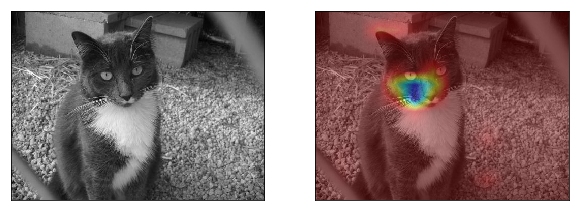

In [354]:
showCAM(test_path+test_list[138])

       This is a cat.


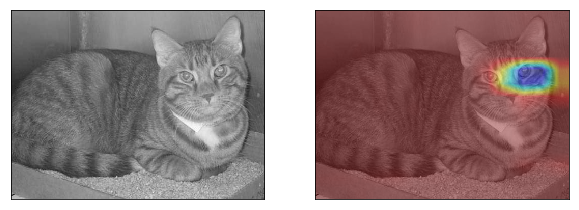

In [355]:
showCAM(test_path+test_list[139])

       This is a cat.


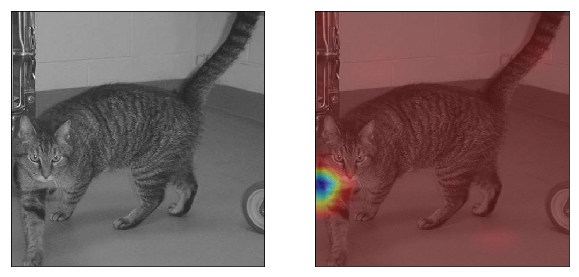

In [356]:
showCAM(test_path+test_list[140])

       This is a dog.


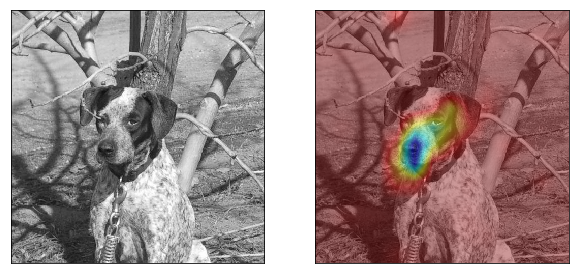

In [357]:
showCAM(test_path+test_list[141])

       This is a cat.


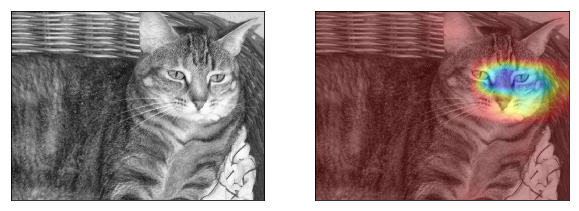

In [358]:
showCAM(test_path+test_list[142])

       This is a cat.


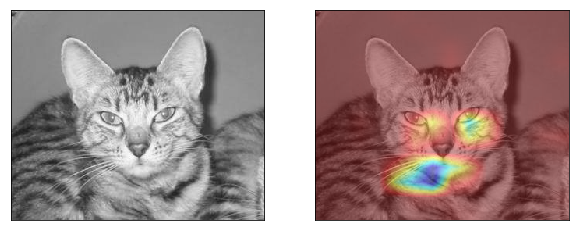

In [359]:
showCAM(test_path+test_list[143])

       This is a dog.


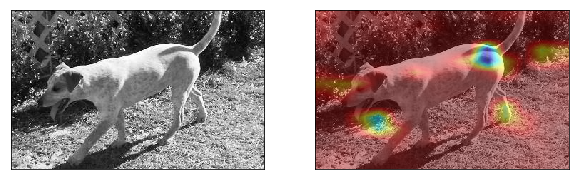

In [360]:
showCAM(test_path+test_list[144])

       This is a dog.


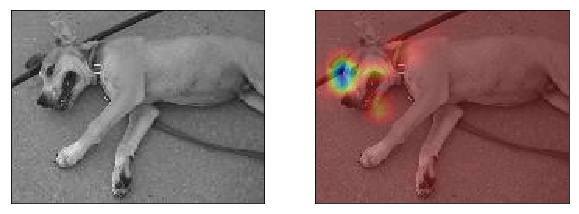

In [361]:
showCAM(test_path+test_list[145])

       This is a cat.


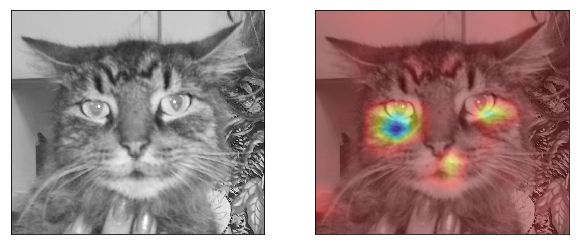

In [362]:
showCAM(test_path+test_list[146])

       This is a dog.


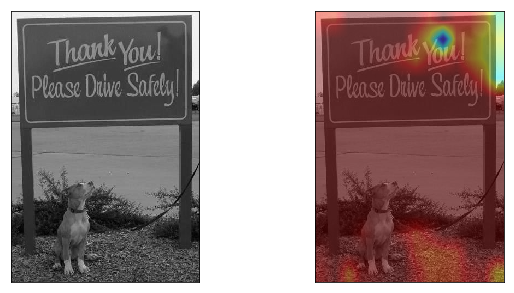

In [363]:
showCAM(test_path+test_list[147])

       This is a cat.


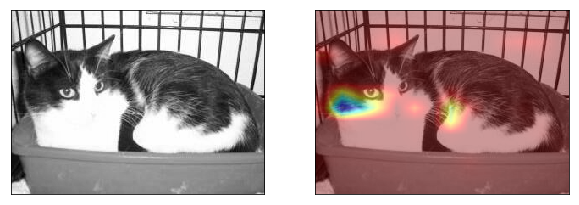

In [364]:
showCAM(test_path+test_list[148])

       This is a dog.


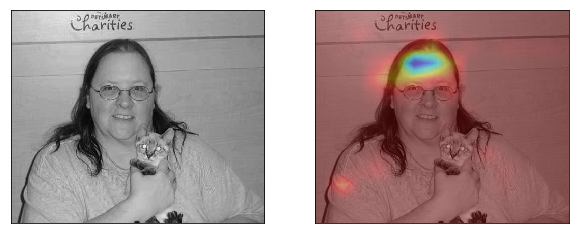

In [365]:
# 失误
showCAM(test_path+test_list[149])

       This is a cat.


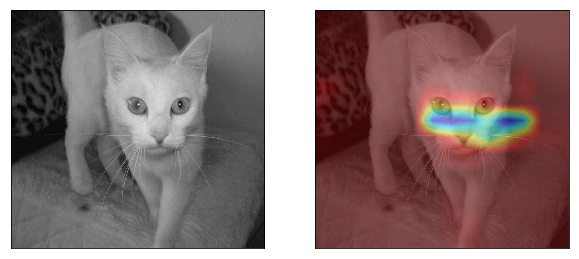

In [366]:
showCAM(test_path+test_list[150])

       This is a cat.


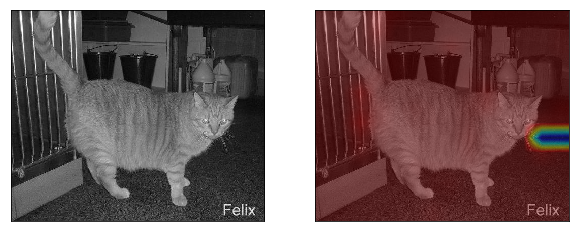

In [367]:
showCAM(test_path+test_list[151])

       This is a dog.


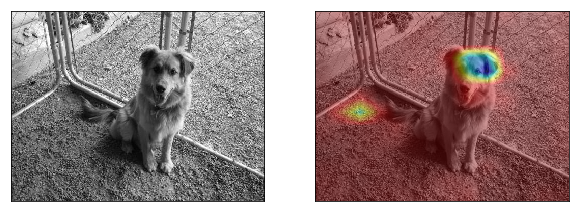

In [368]:
showCAM(test_path+test_list[152])

       This is a cat.


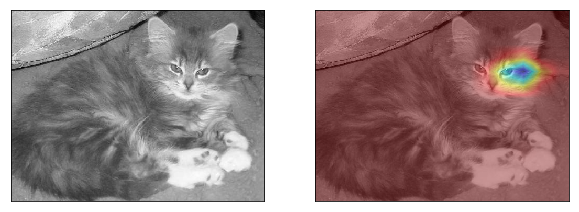

In [369]:
showCAM(test_path+test_list[153])

       This is a cat.


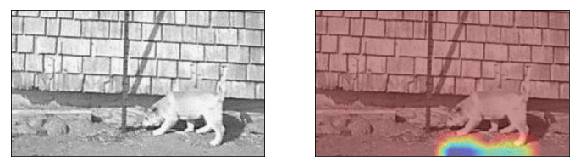

In [370]:
# 出错
showCAM(test_path+test_list[154])

       This is a cat.


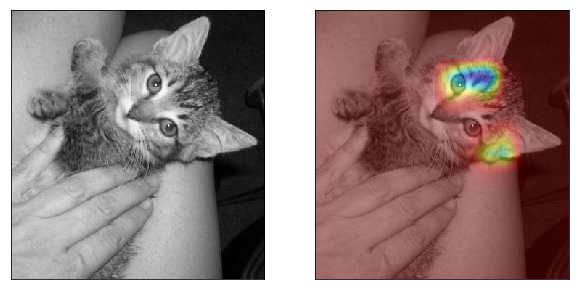

In [371]:
showCAM(test_path+test_list[155])

       This is a cat.


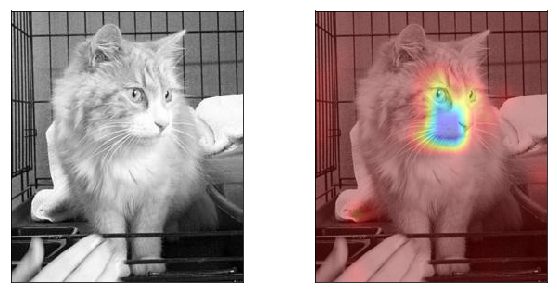

In [372]:
showCAM(test_path+test_list[156])

       This is a dog.


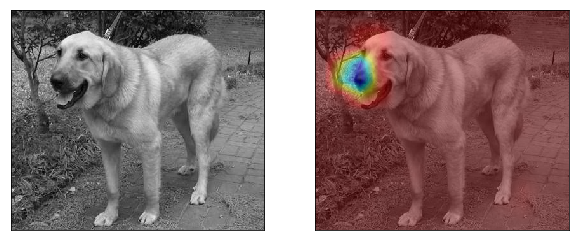

In [373]:
showCAM(test_path+test_list[157])

       This is a dog.


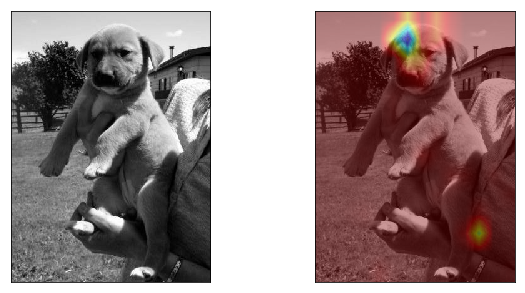

In [374]:
showCAM(test_path+test_list[158])

       This is a dog.


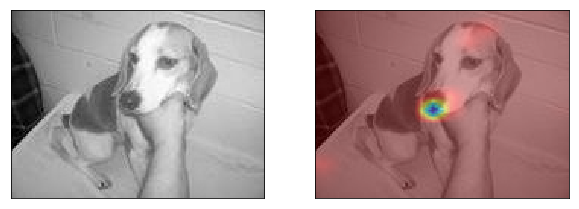

In [375]:
showCAM(test_path+test_list[159])

       This is a cat.


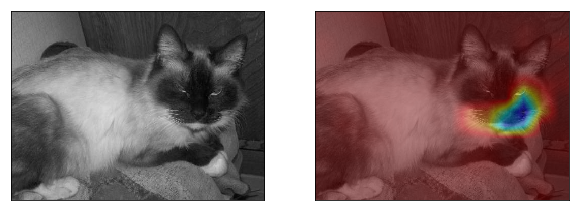

In [376]:
showCAM(test_path+test_list[160])

       This is a cat.


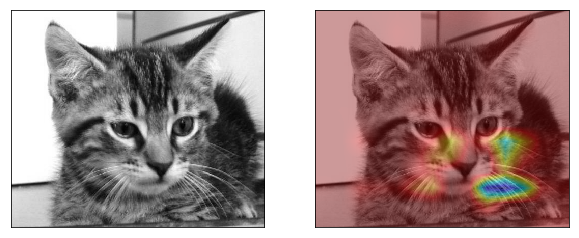

In [377]:
showCAM(test_path+test_list[161])

       This is a dog.


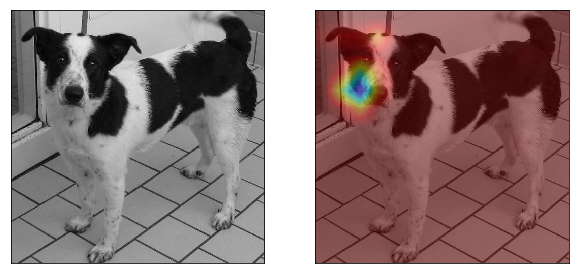

In [378]:
showCAM(test_path+test_list[162])

       This is a dog.


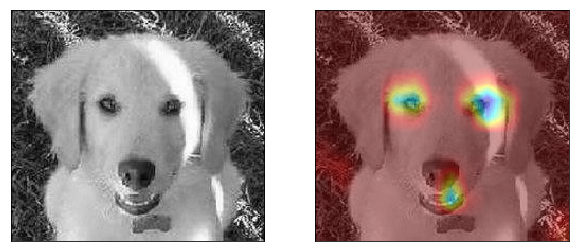

In [379]:
showCAM(test_path+test_list[163])

       This is a dog.


/home/jack/.jackprograms/envs/gpu_tf_keras/lib/python3.6/site-packages/ipykernel_launcher.py:26: RuntimeWarning: invalid value encountered in true_divide


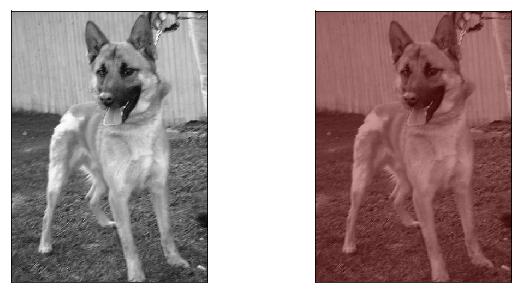

In [380]:
showCAM(test_path+test_list[164])

       This is a dog.


/home/jack/.jackprograms/envs/gpu_tf_keras/lib/python3.6/site-packages/ipykernel_launcher.py:26: RuntimeWarning: invalid value encountered in true_divide


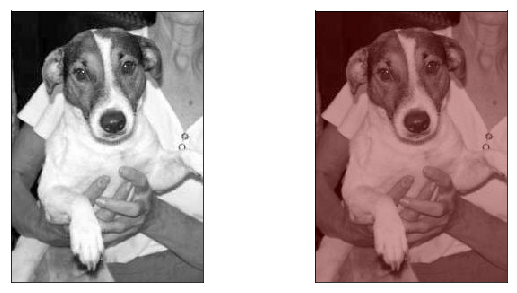

In [381]:
showCAM(test_path+test_list[165])

       This is a dog.


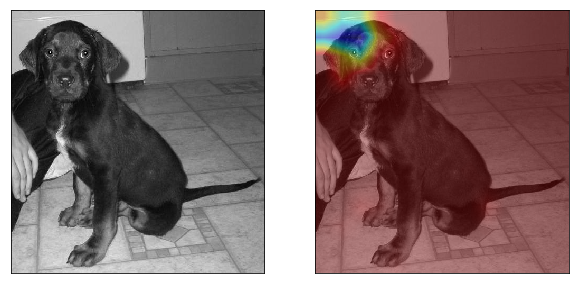

In [382]:
showCAM(test_path+test_list[166])

       This is a cat.


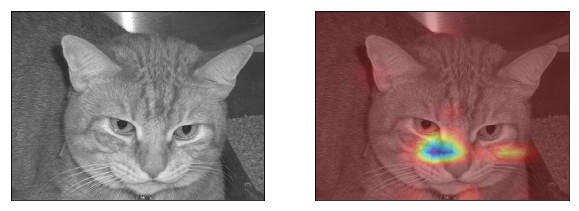

In [383]:
showCAM(test_path+test_list[167])

       This is a cat.


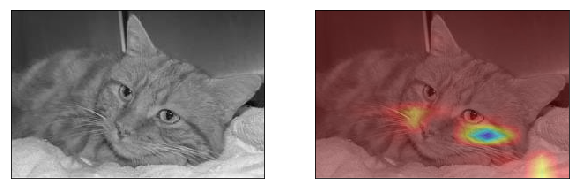

In [384]:
showCAM(test_path+test_list[168])

       This is a dog.


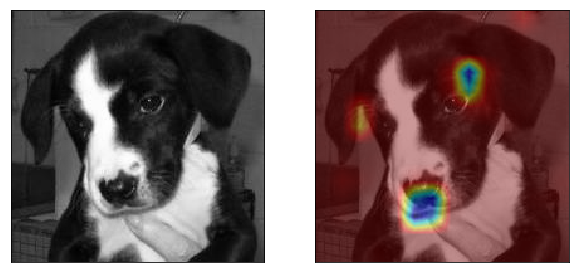

In [385]:
showCAM(test_path+test_list[169])

       This is a cat.


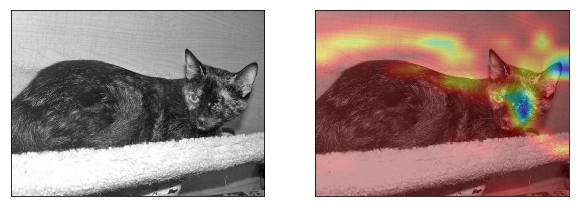

In [386]:
showCAM(test_path+test_list[170])

       This is a dog.


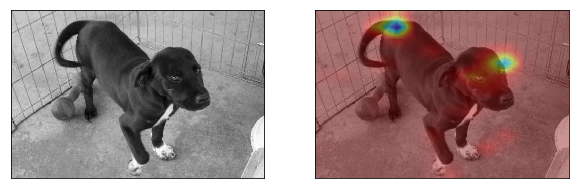

In [387]:
showCAM(test_path+test_list[171])

       This is a cat.


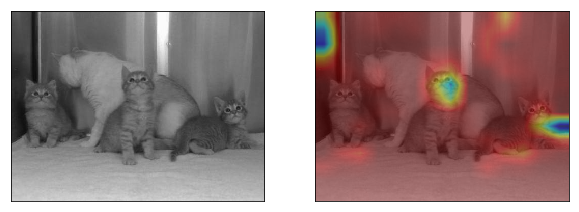

In [388]:
showCAM(test_path+test_list[172])

       This is a cat.


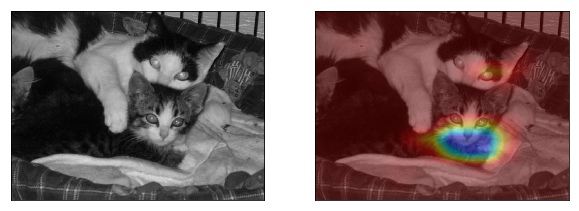

In [389]:
showCAM(test_path+test_list[173])

       This is a cat.


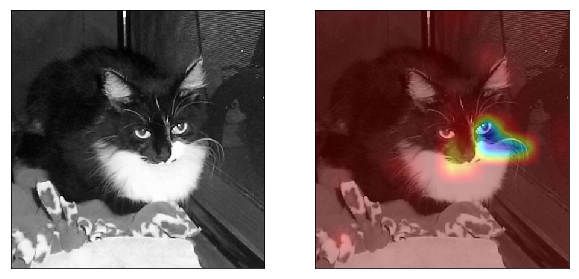

In [390]:
showCAM(test_path+test_list[174])

       This is a cat.


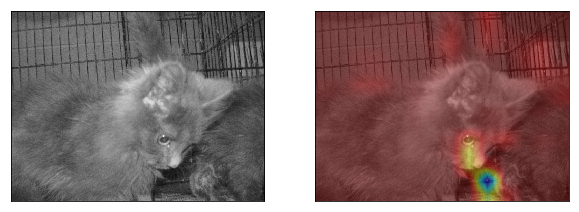

In [391]:
showCAM(test_path+test_list[175])

       This is a dog.


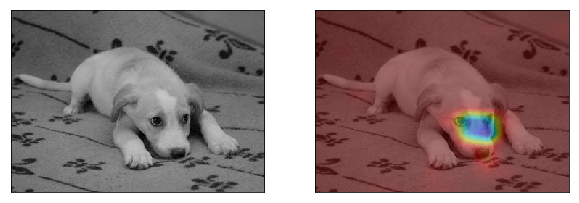

In [393]:
showCAM(test_path+test_list[177])

       This is a cat.


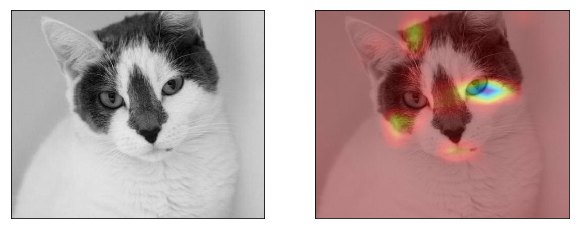

In [394]:
showCAM(test_path+test_list[178])

       This is a dog.


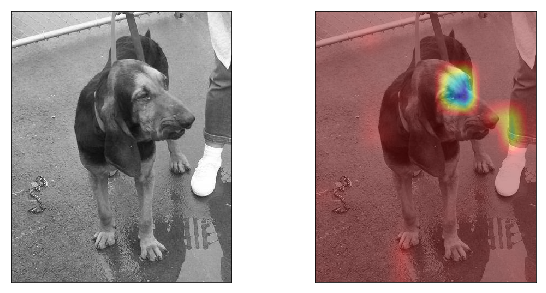

In [395]:
showCAM(test_path+test_list[179])

       This is a dog.


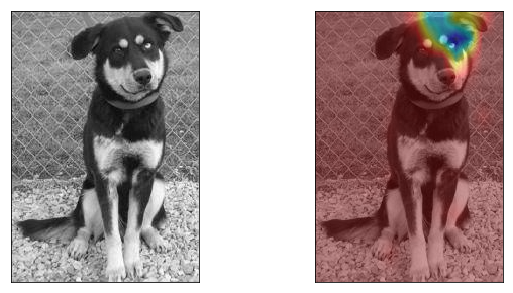

In [396]:
showCAM(test_path+test_list[180])

       This is a dog.


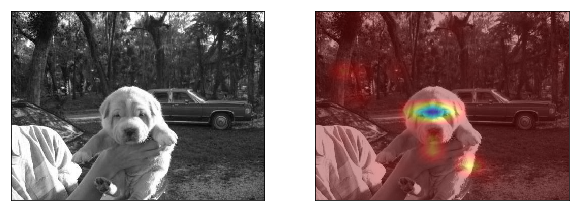

In [397]:
showCAM(test_path+test_list[181])

       This is a cat.


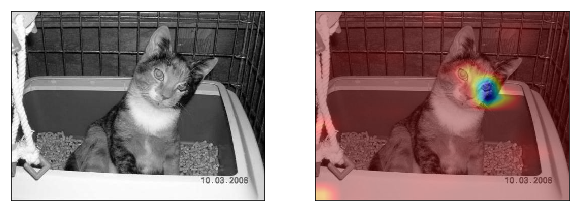

In [398]:
showCAM(test_path+test_list[182])

       This is a dog.


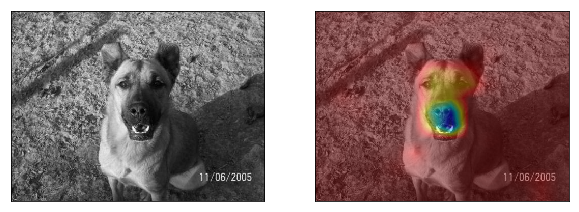

In [399]:
showCAM(test_path+test_list[183])

       This is a cat.


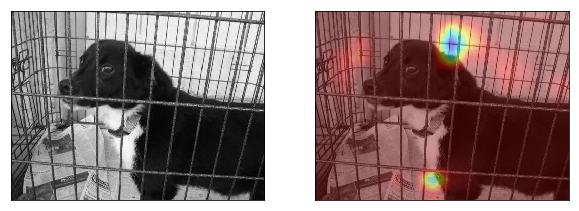

In [400]:
showCAM(test_path+test_list[184])

       This is a dog.


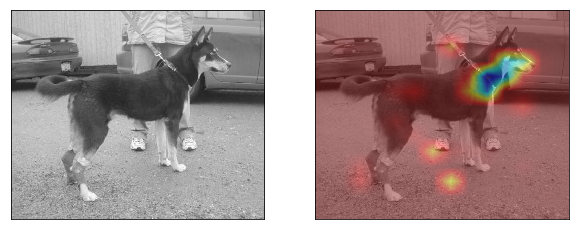

In [401]:
showCAM(test_path+test_list[185])

       This is a cat.


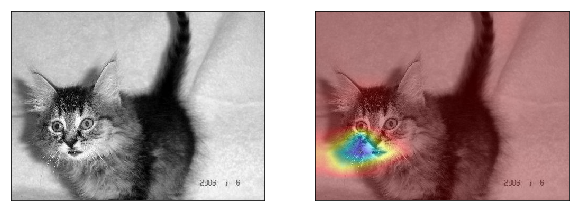

In [402]:
showCAM(test_path+test_list[186])

       This is a dog.


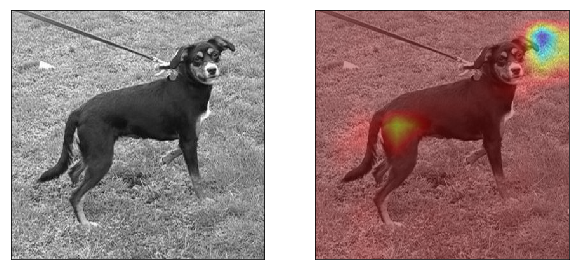

In [403]:
showCAM(test_path+test_list[187])

       This is a dog.


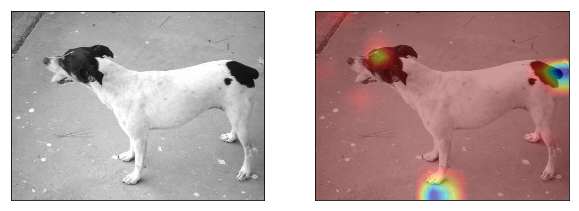

In [404]:
showCAM(test_path+test_list[188])

       This is a cat.


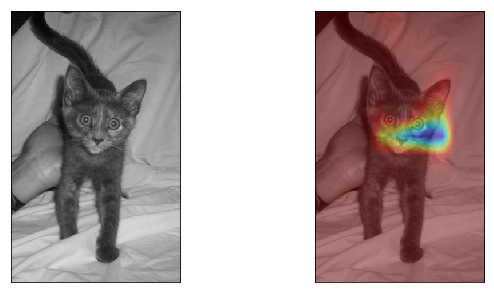

In [405]:
showCAM(test_path+test_list[189])

       This is a cat.


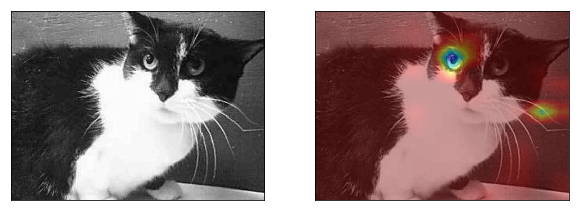

In [406]:
showCAM(test_path+test_list[190])

       This is a dog.


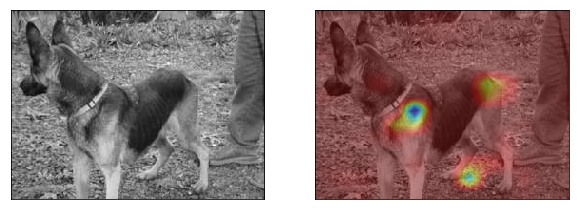

In [407]:
showCAM(test_path+test_list[191])

       This is a cat.


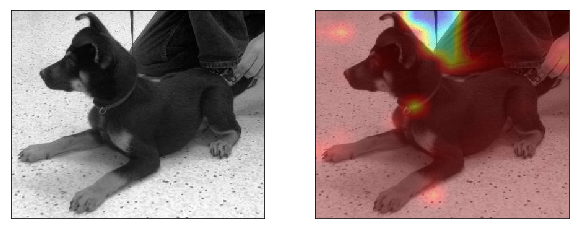

In [408]:
# 失误
showCAM(test_path+test_list[192])

       This is a dog.


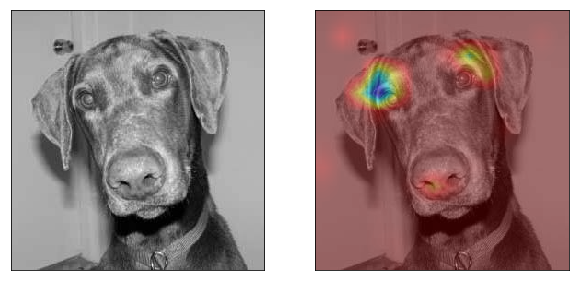

In [409]:
showCAM(test_path+test_list[193])

       This is a cat.


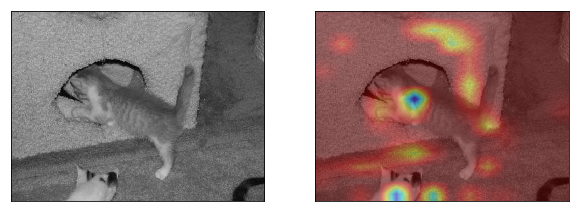

In [410]:
showCAM(test_path+test_list[194])

       This is a cat.


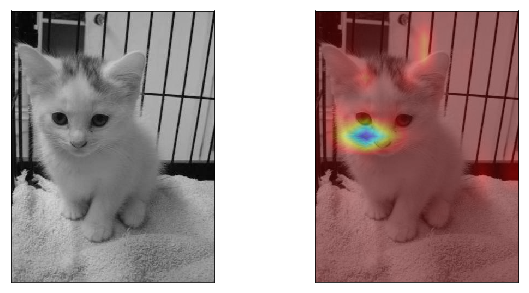

In [411]:
showCAM(test_path+test_list[195])

       This is a cat.


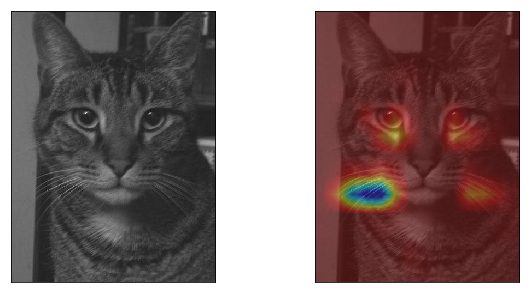

In [412]:
showCAM(test_path+test_list[196])

       This is a cat.


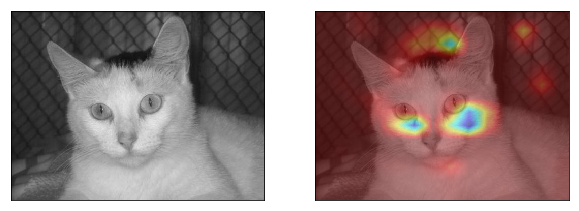

In [413]:
showCAM(test_path+test_list[197])

       This is a dog.


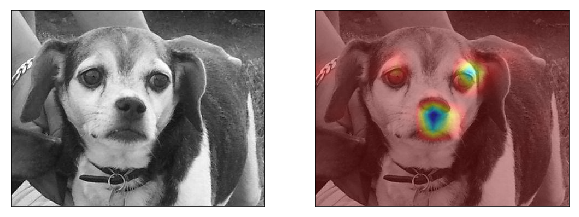

In [414]:
showCAM(test_path+test_list[198])

       This is a cat.


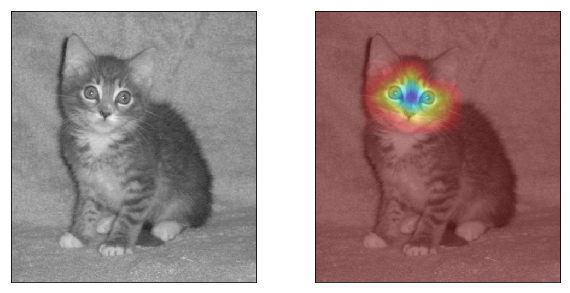

In [415]:
showCAM(test_path+test_list[199])

       This is a dog.


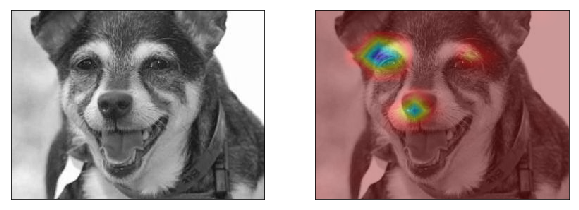

In [416]:
showCAM(test_path+test_list[200])